## **Music features**
A dataset to test your music tagging model

**IMPORT LIBRARIES**

In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt
from matplotlib import cm
from pandas.plotting import scatter_matrix
import seaborn as sns
from mpl_toolkits.axes_grid1 import make_axes_locatable
import random

from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.preprocessing import OneHotEncoder, LabelEncoder, scale
from sklearn.model_selection import train_test_split, StratifiedKFold
from sklearn.neighbors import KNeighborsClassifier
from sklearn.dummy import DummyClassifier
from sklearn.tree import DecisionTreeClassifier

**IMPORT DATASET**

In [4]:
music_df = pd.read_csv("D:\\Downloads\\archive\\data.csv")

In [ ]:
music_df.to_csv('music.csv')

In [5]:
music_df.head()

,filename,tempo,beats,chroma_stft,rmse,spectral_centroid,spectral_bandwidth,rolloff,zero_crossing_rate,mfcc1,...,mfcc12,mfcc13,mfcc14,mfcc15,mfcc16,mfcc17,mfcc18,mfcc19,mfcc20,label
0,blues.00081.au,103.359375,50,0.380260,0.248262,2116.942959,1956.611056,4196.107960,0.127272,-26.929785,...,14.336612,-13.821769,7.562789,-6.181372,0.330165,-6.829571,0.965922,-7.570825,2.918987,blues
1,blues.00022.au,95.703125,44,0.306451,0.113475,1156.070496,1497.668176,2170.053545,0.058613,-233.860772,...,-2.250578,3.959198,5.322555,0.812028,-1.107202,-4.556555,-2.436490,3.316913,-0.608485,blues
2,blues.00031.au,151.999081,75,0.253487,0.151571,1331.073970,1973.643437,2900.174130,0.042967,-221.802549,...,-13.037723,-12.652228,-1.821905,-7.260097,-6.660252,-14.682694,-11.719264,-11.025216,-13.387260,blues
3,blues.00012.au,184.570312,91,0.269320,0.119072,1361.045467,1567.804596,2739.625101,0.069124,-207.208080,...,-0.613248,0.384877,2.605128,-5.188924,-9.527455,-9.244394,-2.848274,-1.418707,-5.932607,blues
4,blues.00056.au,161.499023,74,0.391059,0.137728,1811.076084,2052.332563,3927.809582,0.075480,-145.434568,...,7.457218,-10.470444,-2.360483,-6.783623,2.671134,-4.760879,-0.949005,0.024832,-2.005315,blues


In [6]:
genres = music_df.groupby('label')

['tempo', 'beats', 'chroma_stft', 'rmse', 'spectral_centroid', 'spectral_bandwidth', 'rolloff', 'zero_crossing_rate', 'mfcc1', 'mfcc2', 'mfcc3', 'mfcc4', 'mfcc5', 'mfcc6', 'mfcc7', 'mfcc8', 'mfcc9', 'mfcc10', 'mfcc11', 'mfcc12', 'mfcc13', 'mfcc14', 'mfcc15', 'mfcc16', 'mfcc17', 'mfcc18', 'mfcc19', 'mfcc20']


C:\Users\Neeta Devke\AppData\Local\Temp\ipykernel_10592\4269561255.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=(20,10))


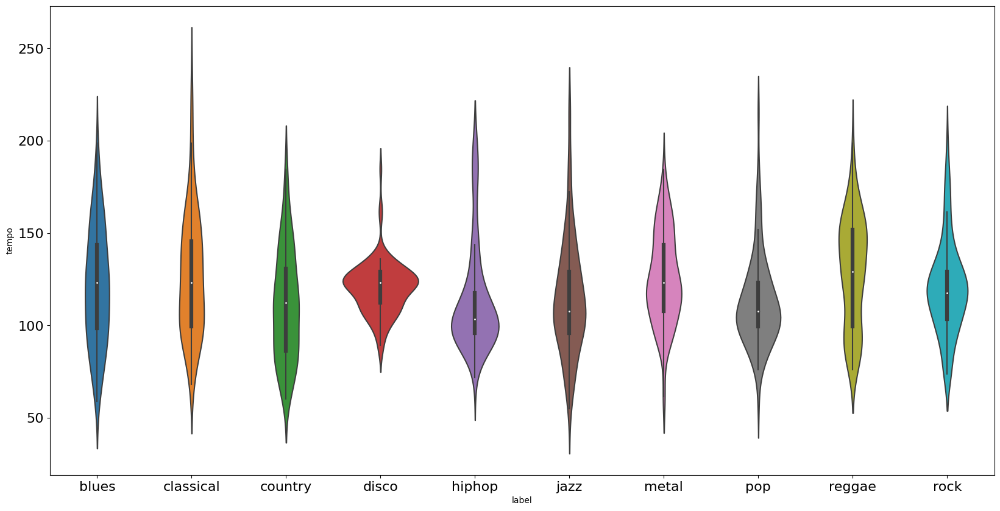

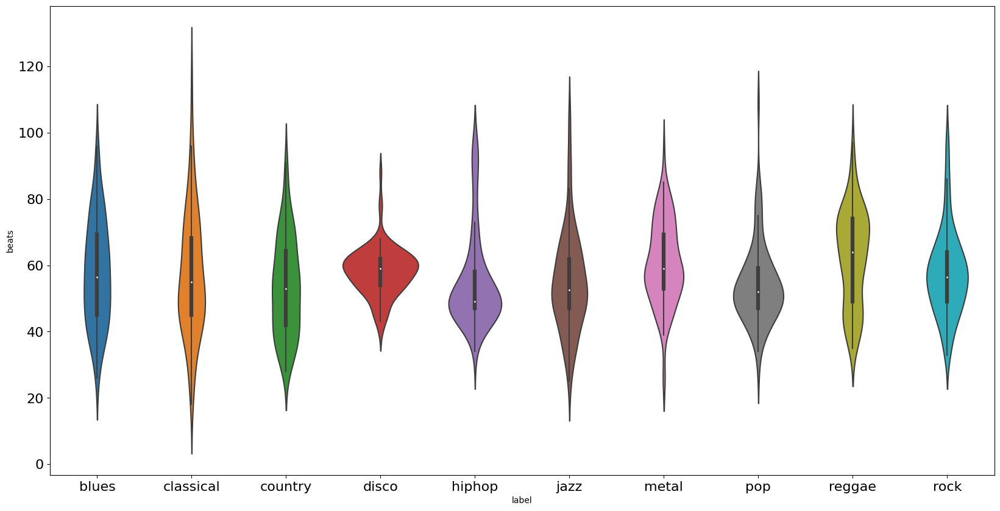

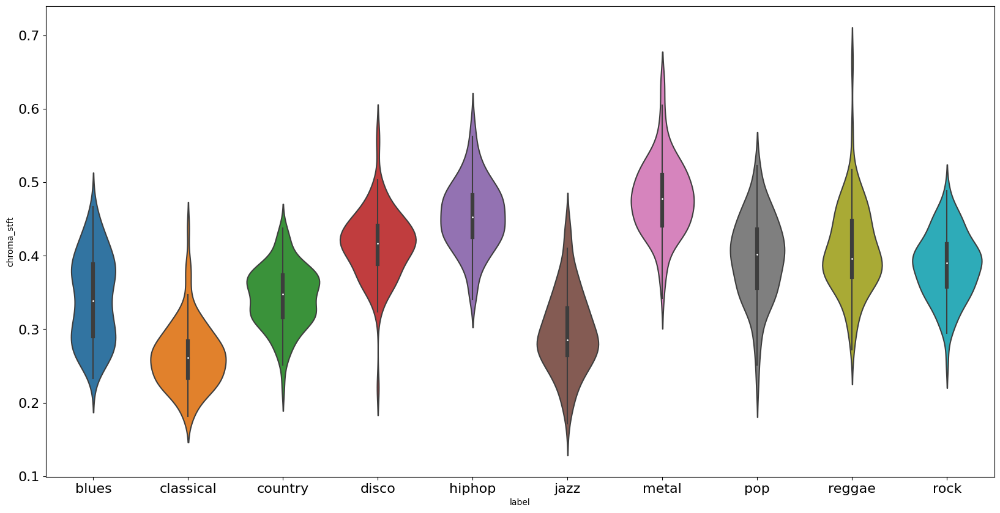

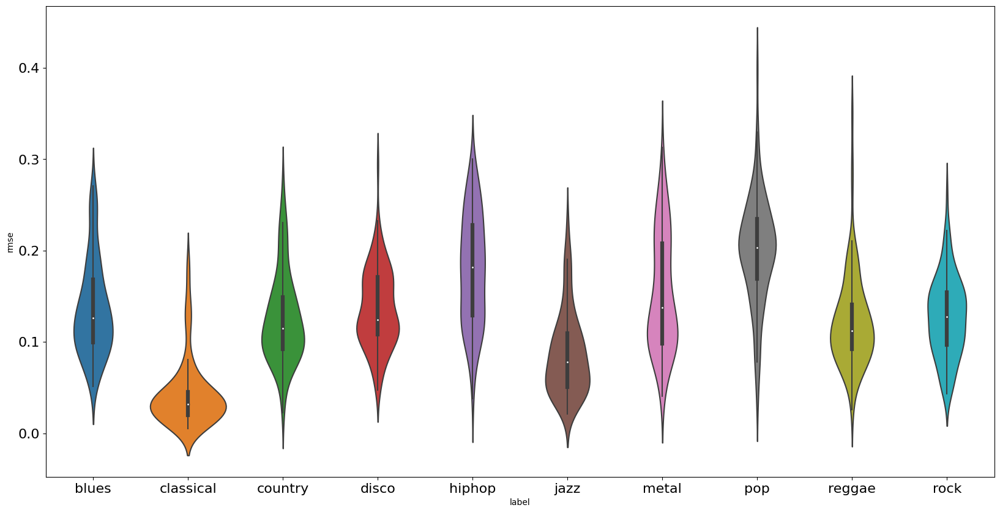

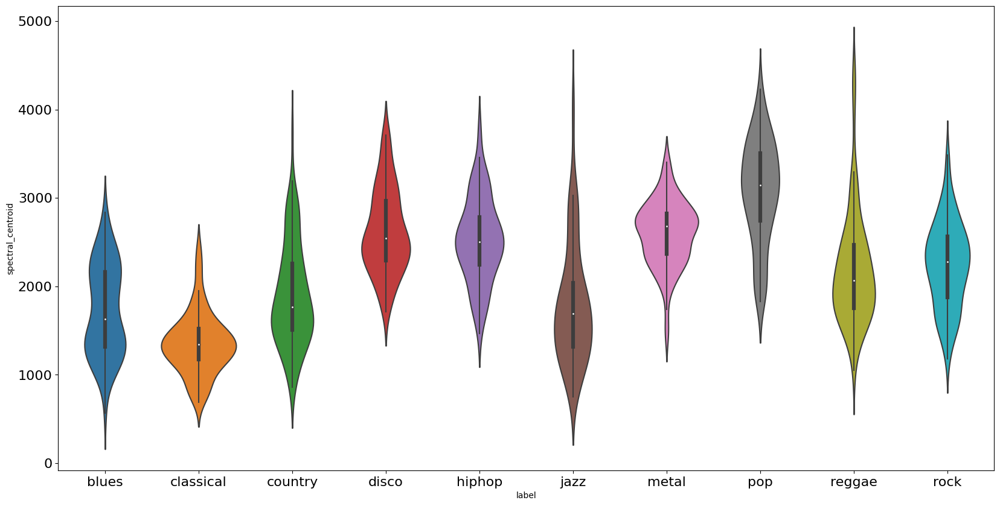

...

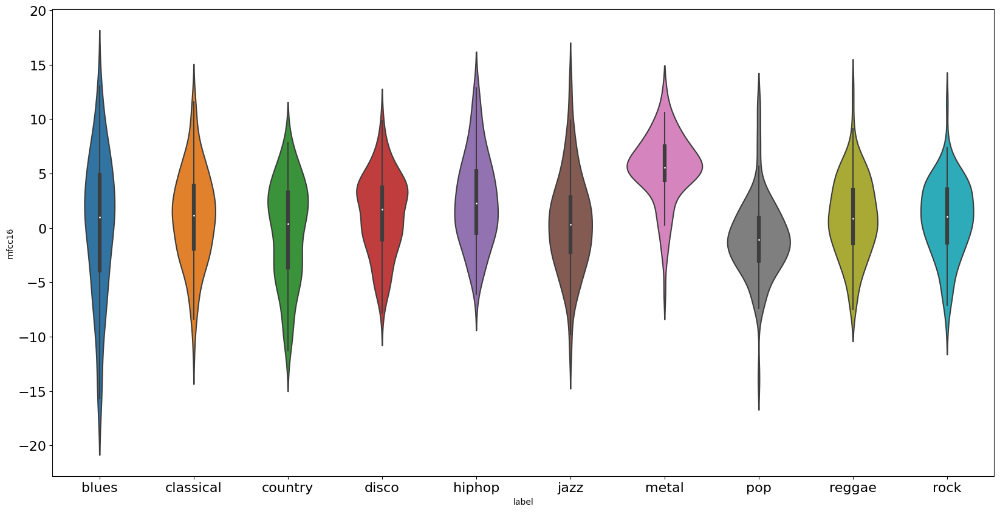

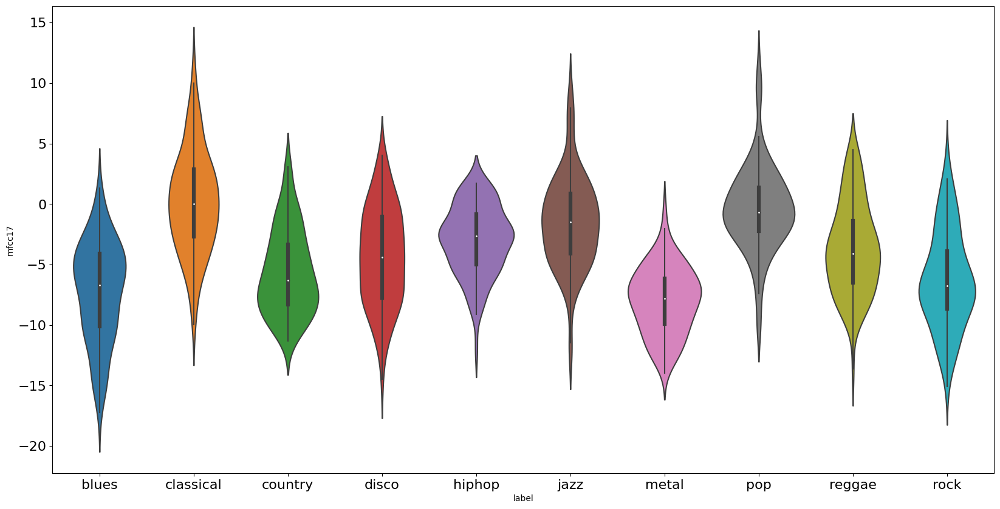

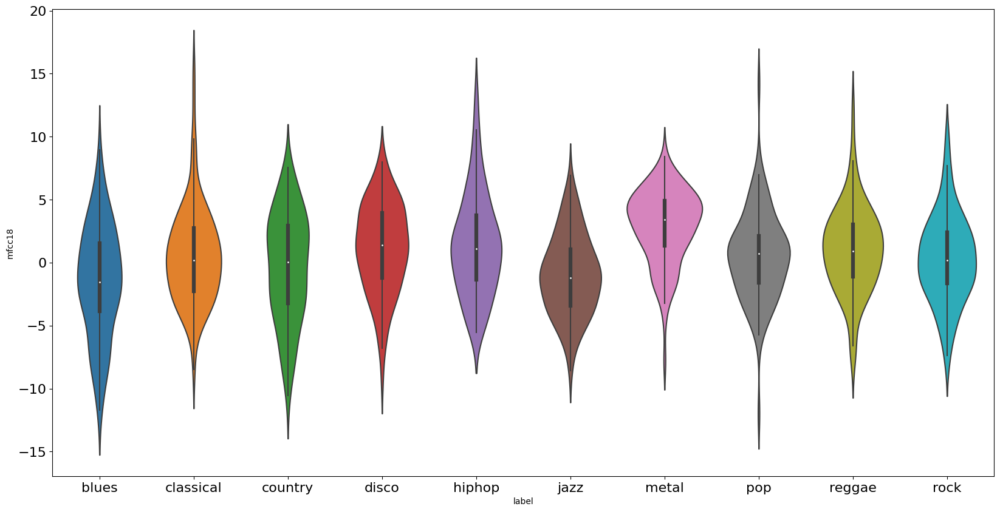

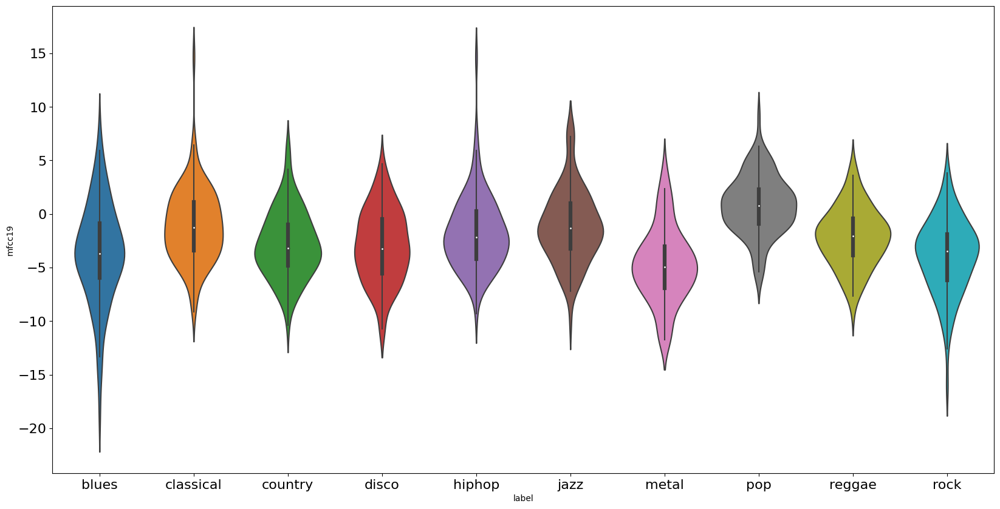

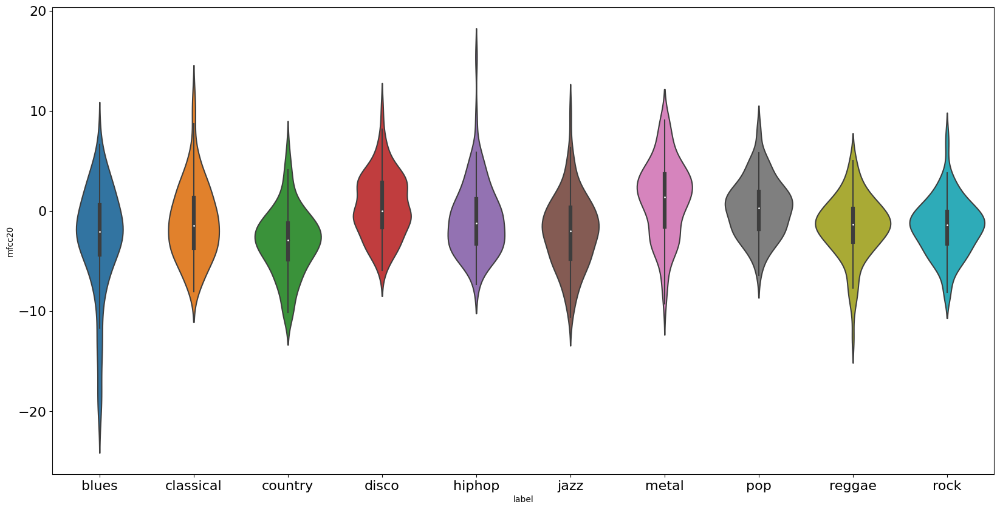

In [8]:
features = list(music_df.columns)
features.remove('filename')
features.remove('label')
print(features)

for feat in features:
    fig, ax = plt.subplots(figsize=(20,10))
    ax.tick_params(axis = 'both', which = 'major', labelsize = 16)
    sns.violinplot(data=music_df, x='label', y=feat, figsize=(20,10))

### **Covariance vs. Correlation**

#### **Covariance**

In [9]:
music_features_df = music_df[features]
music_features_norm_df = scale(music_features_df)

In [10]:
def lower_diag_matrix_plot(matrix, title=None):
    """ Args:
        matrix - the full size symmetric matrix of any type that is lower diagonalized
        title - title of the plot
    """
    plt.style.use('default')
    
    # Create lower triangular matrix to mask the input matrix
    triu = np.tri(len(matrix), k=0, dtype=bool) == False
    matrix = matrix.mask(triu)
    fig, ax = plt.subplots(figsize=(20,20))
    if title:
        fig.suptitle(title, fontsize=32, verticalalignment='bottom')
        fig.tight_layout()
    plot = ax.matshow(matrix)
    
    # Add grid lines to separate the points
    # Adjust the ticks to create visually appealing grid/labels
    # Puts minor ticks every half step and bases the grid off this
    ax.set_xticks(np.arange(-0.5, len(matrix.columns), 1), minor=True)
    ax.set_yticks(np.arange(-0.5, len(matrix.columns), 1), minor=True)
    ax.grid(which='minor', color='w', linestyle='-', linewidth=3)
    # Puts major ticks every full step and bases the labels off this
    ax.set_xticks(np.arange(0, len(matrix.columns), 1))
    ax.set_yticks(np.arange(0, len(matrix.columns), 1))
    plt.yticks(range(len(matrix.columns)), matrix.columns)
    # Must put this here for x axis grid to show
    plt.xticks(range(len(matrix.columns)))
    ax.tick_params(axis='both', which='major', labelsize=24)
    # Whitens (transparent) x labels
    ax.tick_params(axis='x', colors=(0,0,0,0))
    
    # Add a colorbar for reference
    cax = make_axes_locatable(ax)
    cax = cax.append_axes("right", size="5%", pad=0.05)
    cax.tick_params(axis='both', which='major', labelsize=24)
    fig.colorbar(plot, cax=cax, cmap='hot')
    
    # Get rid of borders of plot
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)

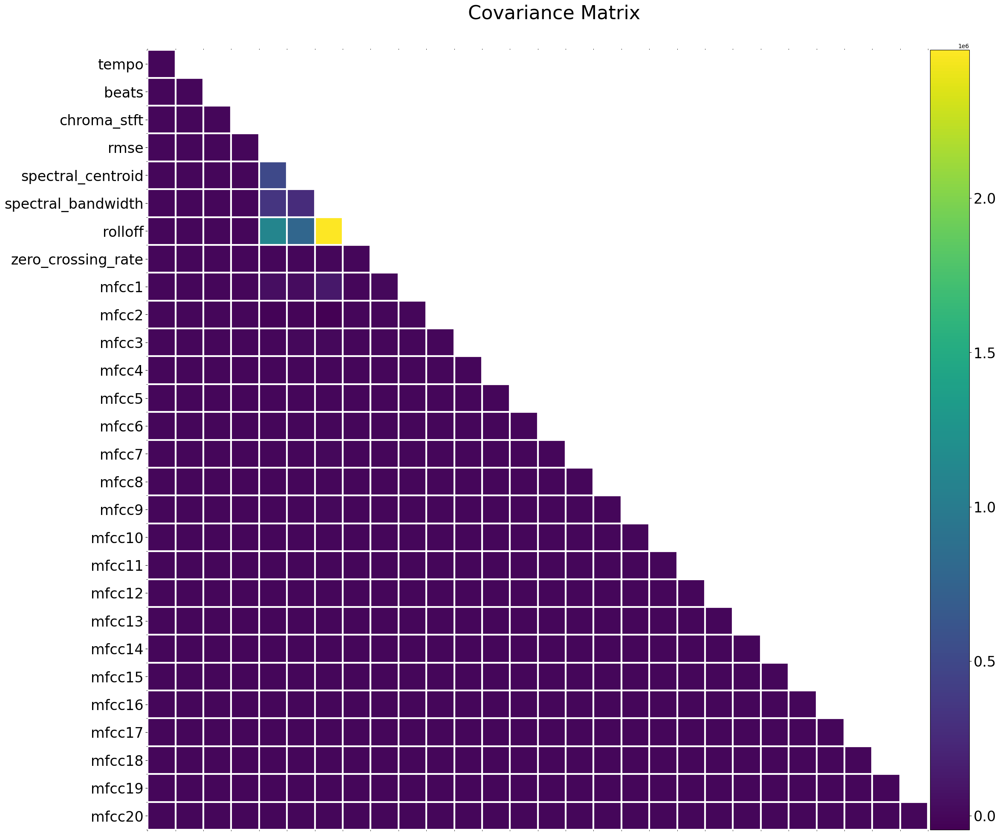

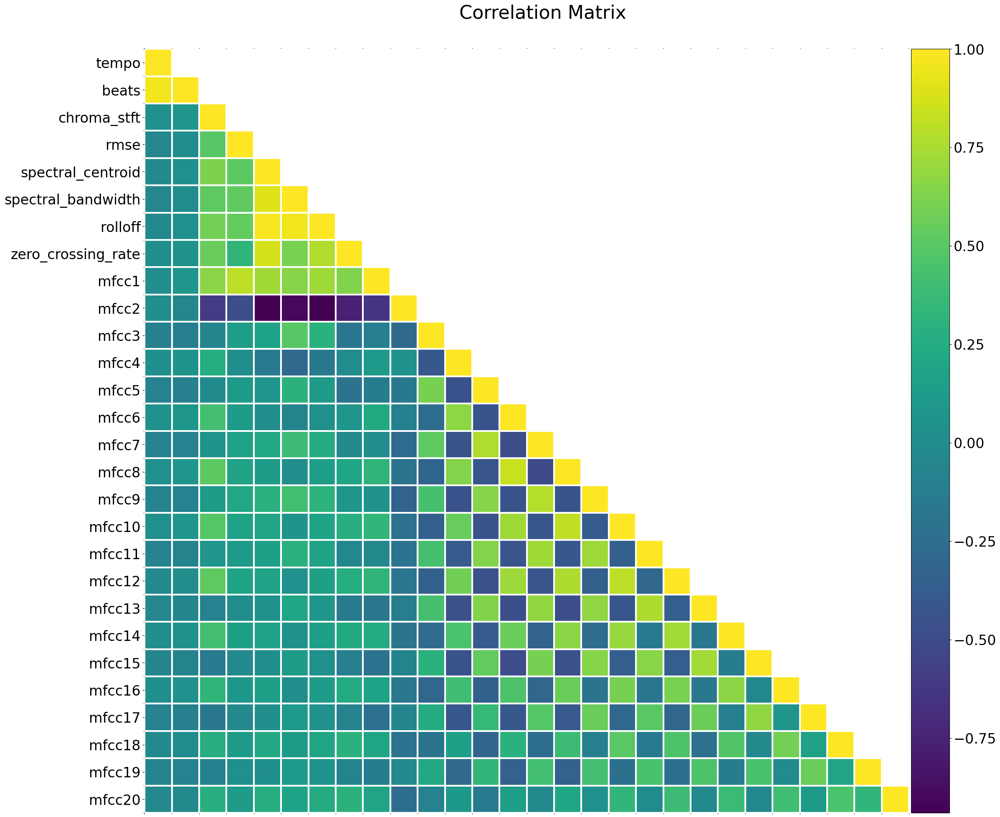

In [11]:
cov_matrix = music_features_df.cov()
lower_diag_matrix_plot(cov_matrix, 'Covariance Matrix')

corr_matrix = music_features_df.corr()
lower_diag_matrix_plot(corr_matrix, 'Correlation Matrix')

*As one can see from above, the Correlation Matrix is much easier to garner information from. This is because the data in it's original form has large values for 'rolloff', 'spectral_centroid' and 'spectral_bandwidth'. Once standardized, correlations can be deduced as in the second plot.*

In [12]:
music_df_no_categories = music_features_df.copy()
music_df_no_categories['label'] = music_df['label']

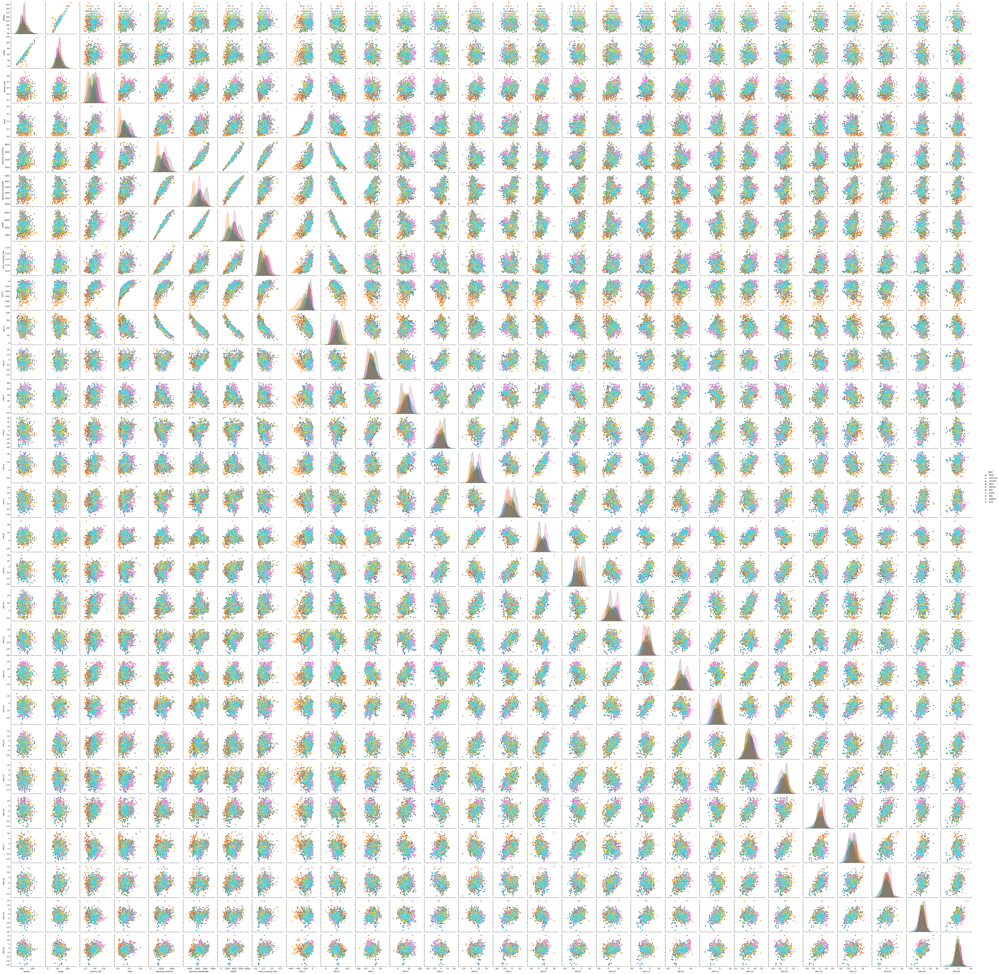

In [13]:
sns.pairplot(music_df, hue='label')

d:\Instagram features\venv\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
d:\Instagram features\venv\lib\site-packages\sklearn\utils\validation.py:1143: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


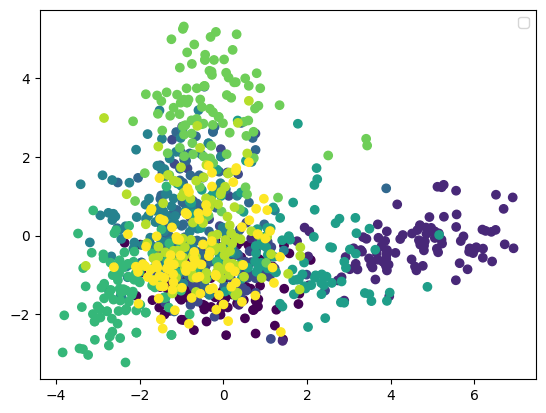

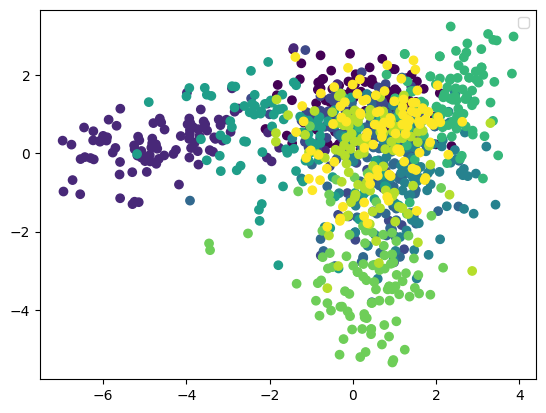

In [17]:
enc = OneHotEncoder()
solvers = ['svd', 'eigen']
for solver in solvers:
    clf = LinearDiscriminantAnalysis(solver=solver, n_components=2)
    le = LabelEncoder()

    new_labels = pd.DataFrame(le.fit_transform(music_df['label']))
    music_df['label'] = new_labels

    params = clf.fit_transform(music_features_norm_df, new_labels,)
    fig, ax = plt.subplots()
    labels_list = list(set(list(new_labels)))
    ax.scatter(params[:,0], params[:,1], c=new_labels.values.reshape(params[:,0].shape))
    ax.legend()

*As can be seen above, LDA to two variables doesn't give us a ton of separation in the data. Maybe we should keep most of our features?*

**Let's try to do just this, and run a kNN classifier on the data**

In [18]:
def param_search(param_names, params_list, model, data, plot=True, seed=None, verbose=False):
    params_accuracies = []
    train_data, train_labels, test_data, test_labels = data
    for param_name, param_list in zip(param_names, params_list):
        accuracies = []
        kwargs = {}
        if verbose:
            print("--------------------------------")
            print("Parameter Under Test: {}\n".format(param_name))
        if type(param_list) != list:
            kwargs[param_name] = param_list
            continue
        for param_val in param_list:
            if verbose: print("Parameter search ({0} -> {1})".format(param_name, param_val))
            kwargs[param_name] = param_val
            classifier = model(**kwargs)
            classifier.fit(train_data, train_labels)
            accuracy = classifier.score(test_data, test_labels)
            accuracies.append(accuracy)
        params_accuracies.append(accuracies)
        if plot:
            fig, ax = plt.subplots()
            ax.plot(param_list, accuracies)
        if verbose: print("--------------------------------")
    if type(param_list) != list:
        kwargs[param_name] = param_list
        classifier = model(**kwargs)
        classifier.fit(train_data, train_labels)
        accuracy = classifier.score(test_data, test_labels)
        params_accuracies.append([accuracy])
    return params_accuracies

Random State: 40835
Training on fold 1/10...

[] [[0.4]]
Training on fold 2/10...

[['K Fold Results']] [[0.4]]
Training on fold 3/10...

[['K Fold Results']] [[0.55]]
Training on fold 4/10...

[['K Fold Results']] [[0.48]]
Training on fold 5/10...

[['K Fold Results']] [[0.47]]
Training on fold 6/10...

[['K Fold Results']] [[0.5]]
Training on fold 7/10...

[['K Fold Results']] [[0.5]]
Training on fold 8/10...

[['K Fold Results']] [[0.41]]
Training on fold 9/10...

[['K Fold Results']] [[0.52]]
Training on fold 10/10...

[['K Fold Results']] [[0.46]]


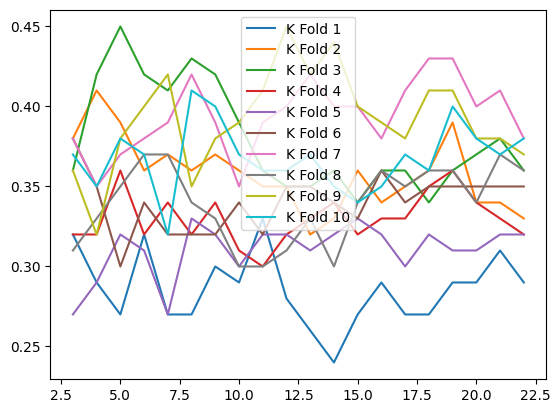

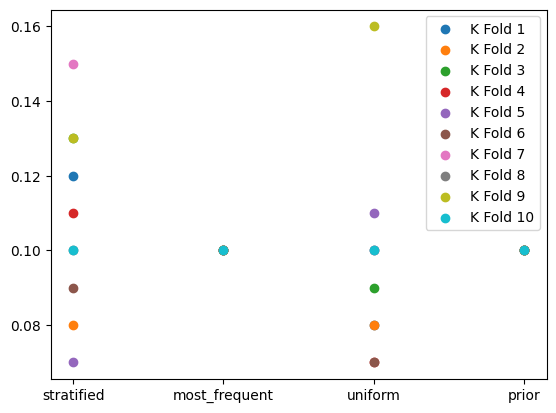

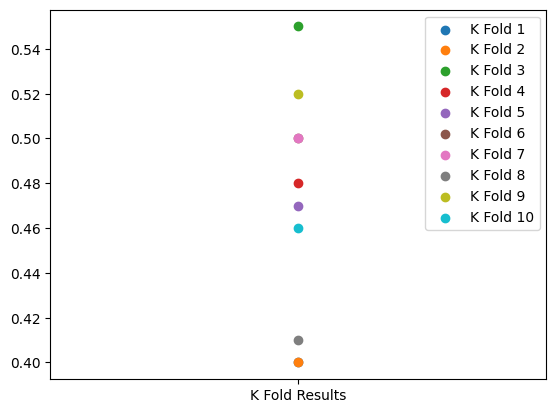

In [19]:
param_names = ['n_neighbors']
params_list = [[i+3 for i in range(20)]]
dummy_param_names = ['strategy']
dummy_params_list = [['stratified', 'most_frequent', 'uniform', 'prior']]
tree_param_names = ['min_samples_split', 'max_depth']
tree_params_list = [10, 8]
tree_params_lists_only = [x for x in tree_params_list if type(x) == list]
dummy_params_lists_only = [x for x in dummy_params_list if type(x) == list]
params_lists_only = [x for x in params_list if type(x) == list]
folds = 10
random_state = random.randint(1, 65536)
print("Random State: {}".format(random_state))

cv = StratifiedKFold(n_splits=folds,
                     shuffle=True,
                     random_state=random_state,
                     )

data = list(cv.split(music_features_df, music_df['label']))
fig, ax = plt.subplots()
dummy_fig, dummy_ax = plt.subplots()
tree_fig, tree_ax = plt.subplots()

for i, indices in enumerate(data):
    train_index, test_index = indices
    title = "Training on fold {}/{}...\n".format(i+1, len(data))
    print(title)
    train_data = music_features_df.iloc[train_index]
    train_labels = music_df['label'].iloc[train_index]
    test_data = music_features_df.iloc[test_index]
    test_labels = music_df['label'].iloc[test_index]
    full_data = (train_data, train_labels, test_data, test_labels)
    
    dummy_accuracies = param_search(dummy_param_names, 
                                    dummy_params_list, 
                                    DummyClassifier, 
                                    data=full_data,
                                    plot=False)
    for X, y in zip(dummy_params_list, dummy_accuracies):
        dummy_ax.scatter(X, y, label='K Fold {}'.format(i+1))
        dummy_ax.legend()
    
    accuracies = param_search(param_names, 
                              params_list, 
                              KNeighborsClassifier, 
                              data=full_data,
                              plot=False)
    for X, y in zip(params_list, accuracies):
        ax.plot(X, y, label='K Fold {}'.format(i+1))
        ax.legend()
    
    tree_accuracies = param_search(tree_param_names, 
                                   tree_params_list, 
                                   DecisionTreeClassifier,
                                   data=full_data,
                                   plot=False)
    print(tree_params_lists_only, tree_accuracies)
    if not tree_params_lists_only:
        tree_params_lists_only = [['K Fold Results']]
    for X, y in zip(tree_params_lists_only, tree_accuracies):
        tree_ax.scatter(X, y, label='K Fold {}'.format(i+1))
        tree_ax.legend()